In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import requests

import geopandas as gpd
import contextily as ctx

from scripts.get_google_images import *
from scripts.train_is_model import *
from scripts.is_model_inference import *

In [2]:
intersections = pd.read_csv('data/processed/intersection_collision_frequency.csv')
intersections.iloc[0].T

lat                                40.744167
lng                                -73.91248
intersection                            True
lat_int                            40.744167
lng_int                            -73.91248
mtfcc1                                 S1400
mtfcc2                                 S1400
adminCode1                                NY
distance                                 0.0
bearing                                    0
placename                           New York
street1Bearing                           102
street2Bearing                           188
adminName2                            Queens
postalcode                           11377.0
countryCode                               US
street1                             43rd Ave
street2                              52nd St
adminName1                          New York
distance_site_int                        0.0
dupe_key                 40.744167_-73.91248
ped_collisions_sum                       5.0
cyc_collis

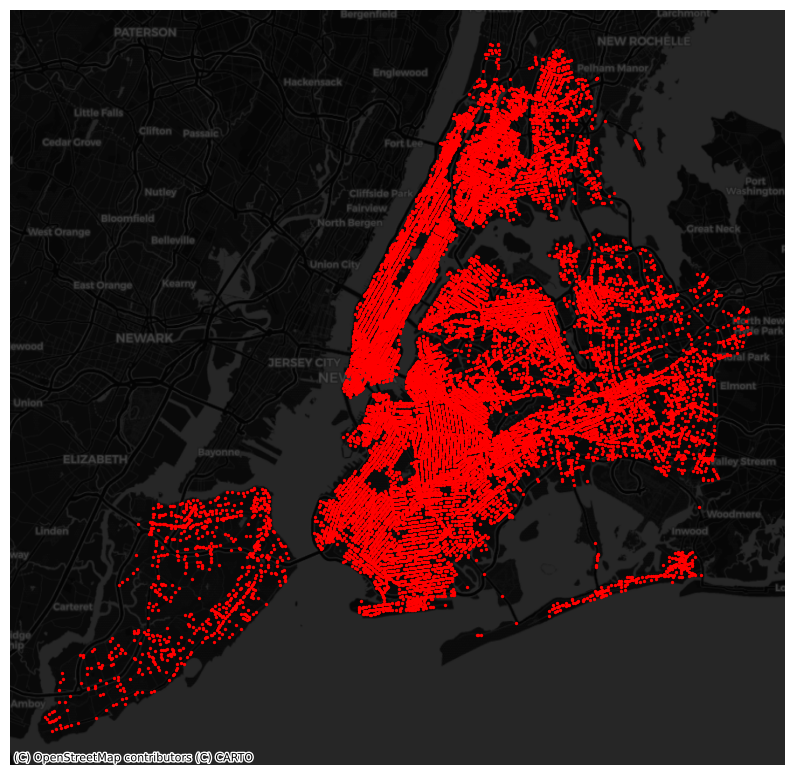

In [3]:
ints_only_pedcyc = intersections[intersections.pedcyc_collisions_sum > 0]

gdf_intersections = gpd.GeoDataFrame(
    ints_only_pedcyc, crs="EPSG:4326",
    geometry=gpd.points_from_xy(ints_only_pedcyc.lng, ints_only_pedcyc.lat)
)

# Plot with varying opacity and size
ax = gdf_intersections.plot(
    figsize=(10, 10),
    markersize=2,
    color='red'
)

ctx.add_basemap(ax, source=ctx.providers.CartoDB.DarkMatter, crs=gdf_intersections.crs.to_string())
plt.axis('off')
plt.show()

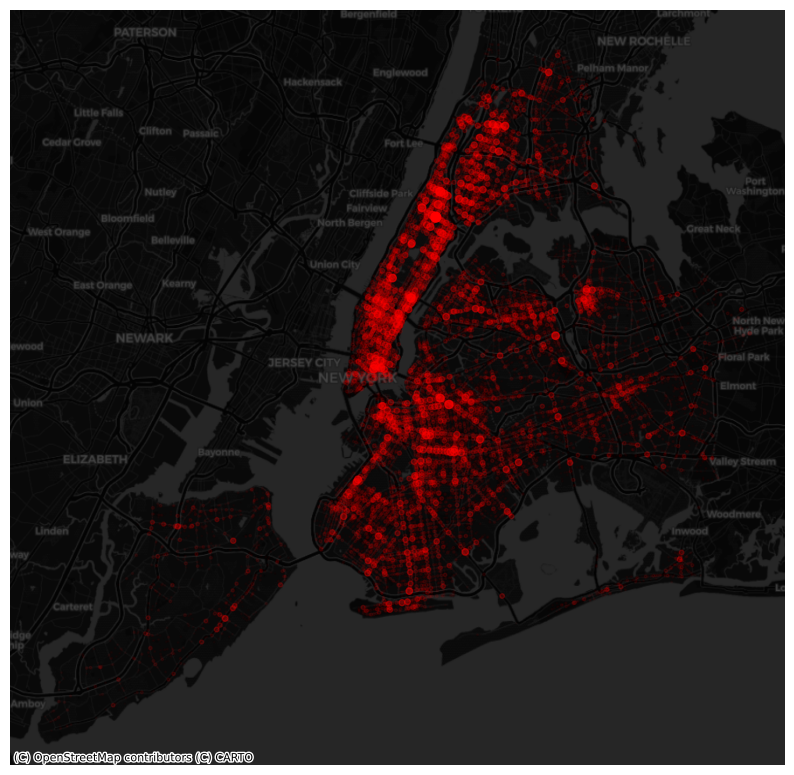

In [4]:
# Normalize the collision counts to 0-1 range for opacity
max_collisions = ints_only_pedcyc.pedcyc_collisions_sum.max()
normalized_collisions = ints_only_pedcyc.pedcyc_collisions_sum / max_collisions

# Plot with varying opacity and size
ax = gdf_intersections.plot(
    figsize=(10, 10),
    alpha=normalized_collisions,  # opacity varies with collision count
    markersize=normalized_collisions * 50,  # size varies with collision count
    color='red'
)

ctx.add_basemap(ax, source=ctx.providers.CartoDB.DarkMatter, crs=gdf_intersections.crs.to_string())
plt.axis('off')
plt.show()

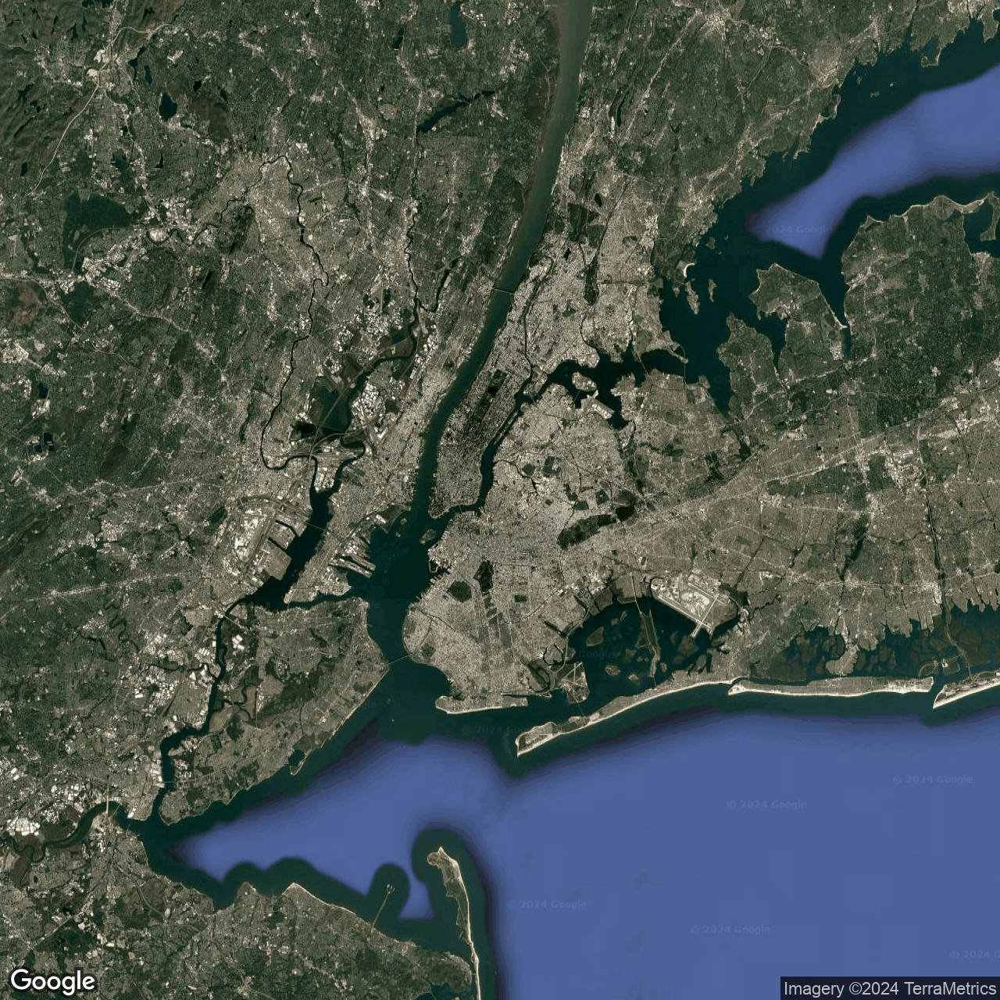

In [5]:
get_satellite_image(
    lat=40.7128, 
    lon=-73.9554,
    zoom=10
)

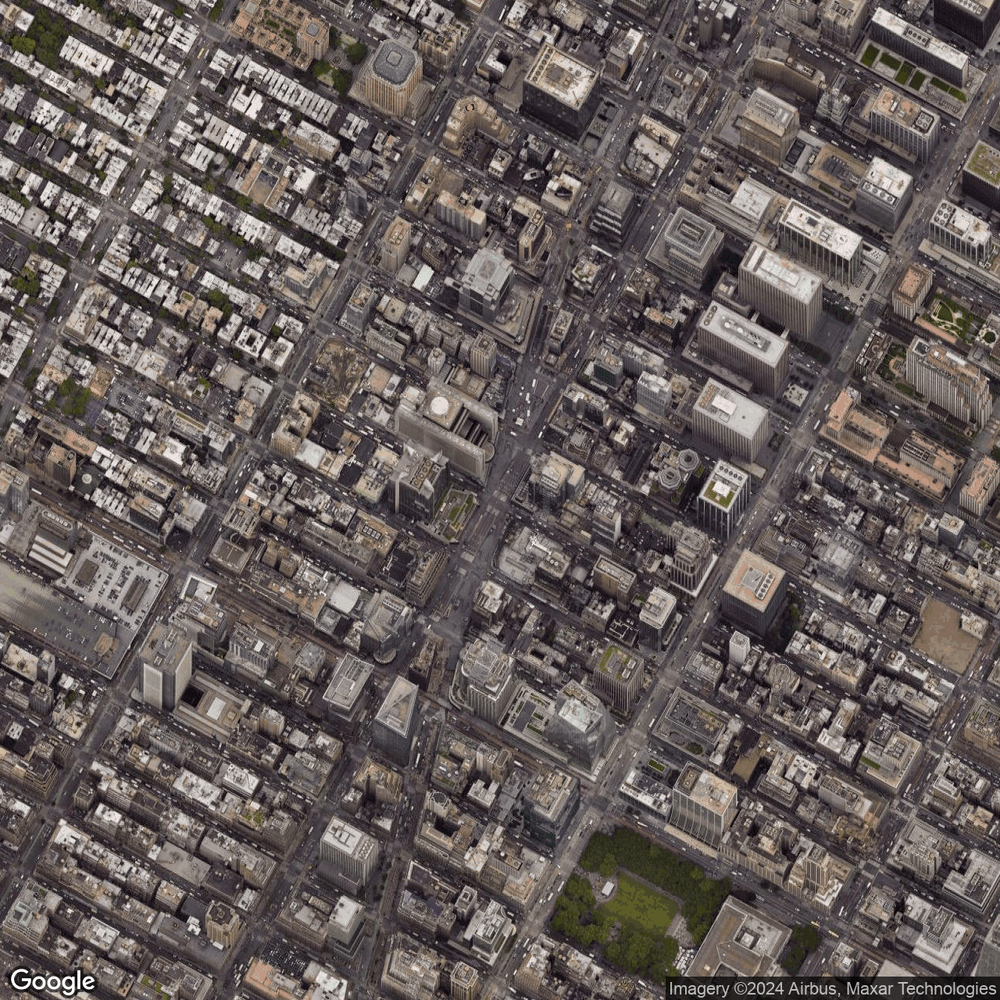

In [6]:
get_satellite_image(
    lat=40.7580, 
    lon=-73.9855,
    zoom=16
)

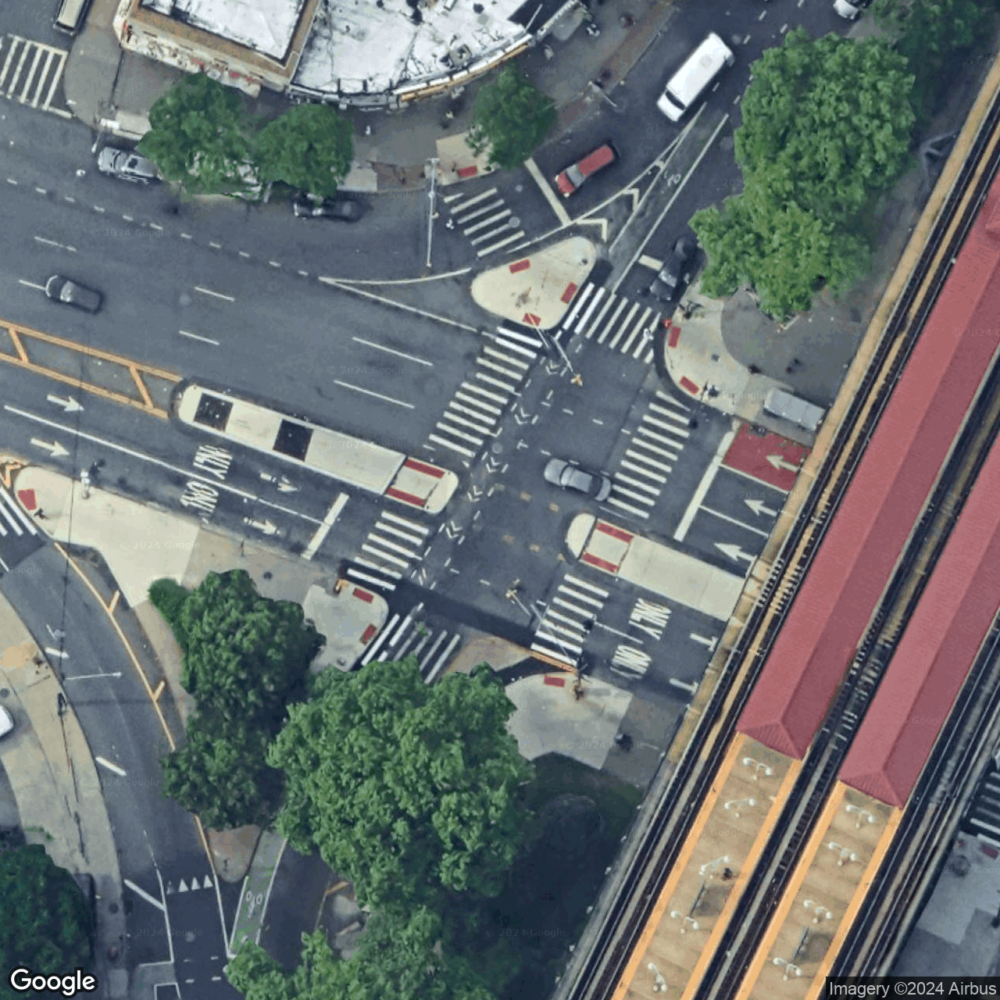

In [7]:
image_name = '40.877513_-73.866874.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)
image = Image.open(image_file_path)
display(image)

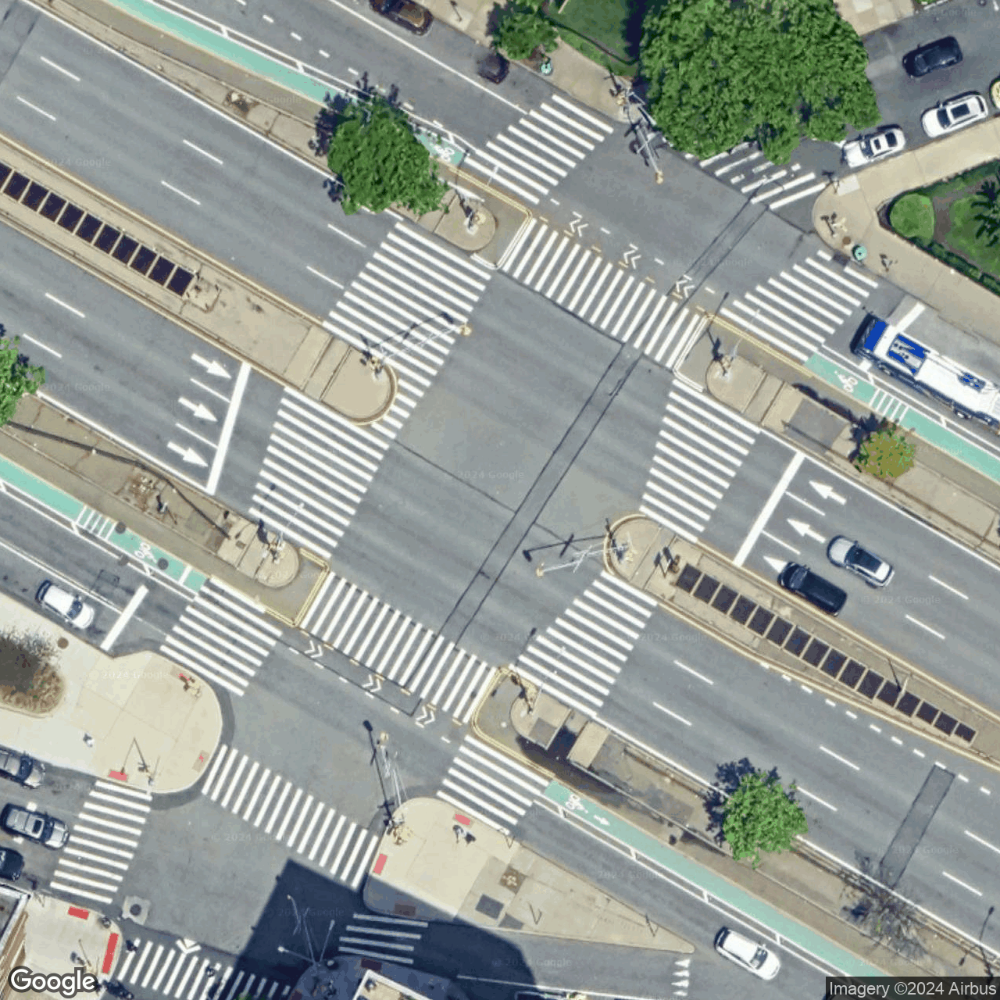

In [8]:
image_name = '40.721888_-73.845019.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)
image = Image.open(image_file_path)
display(image)

In [9]:
# Load COCO data and splits
with open('data/annotations/dataset.json', 'r') as f:
    coco_data = json.load(f)
class_names = [x['name'] for x in coco_data['categories']]

with open('data/split_mapping.json', 'r') as f:
    splits = json.load(f)

coco_data['categories']

# Register datasets
annotations_file = os.path.join(ANNOTATIONS_DIR, 'dataset.json')
register_coco_instances('all_data_for_metadata', {}, annotations_file, IMAGES_DIR)
dataset_dicts = DatasetCatalog.get('all_data_for_metadata')
metadata = MetadataCatalog.get('all_data_for_metadata')

# Setup model
model_file_path = os.path.join(MODEL_DIR, MODEL_NAME)
num_classes = len(class_names)
predictor = setup_predictor(model_file_path, num_classes, threshold=0.7)

12/21/2024 14:56:27 - WARNING - detectron2.data.datasets.coco -   
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

12/21/2024 14:56:27 - INFO - detectron2.data.datasets.coco -   Loaded 206 images in COCO format from data/annotations\dataset.json
12/21/2024 14:56:28 - INFO - detectron2.checkpoint.detection_checkpoint -   [DetectionCheckpointer] Loading from models\model_final.pth ...
12/21/2024 14:56:28 - INFO - fvcore.common.checkpoint -   [Checkpointer] Loading from models\model_final.pth ...


c:\Users\Keith\miniconda3\envs\intersections\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


40.721888_-73.845019.png


{'intersection_total_count': 4,
 'crosswalk_total_count': 14,
 'median_total_count': 14,
 'doubleYellow_total_count': 0,
 'bikeLane_total_count': 4,
 'bikeLaneInt_total_count': 4,
 'overpass_total_count': 0,
 'busLane_total_count': 0,
 'crosswalk_main_count': 5,
 'median_main_count': 7,
 'doubleYellow_main_count': 0,
 'bikeLane_main_count': 0,
 'bikeLaneInt_main_count': 2,
 'overpass_main_count': 0,
 'busLane_main_count': 0,
 'overhead_area': 0.0,
 'overpass_area': 0.0,
 'int_side1_length': 242.4396832203837,
 'int_side2_length': 412.70449476592813,
 'int_side3_length': 232.62201099638014,
 'int_side4_length': 398.8997367760475,
 'intersection_main_area': 121420,
 'cw_side1_length': 274.05291459862275,
 'cw_side1_width': 67.00530817887638,
 'cw_side2_length': 409.63859646185415,
 'cw_side2_width': 99.34870521305638,
 'cw_side3_length': 256.4156781478075,
 'cw_side3_width': 78.47414068183829,
 'cw_side4_length': 450.1310920165369,
 'cw_side4_width': 130.97517822171253}

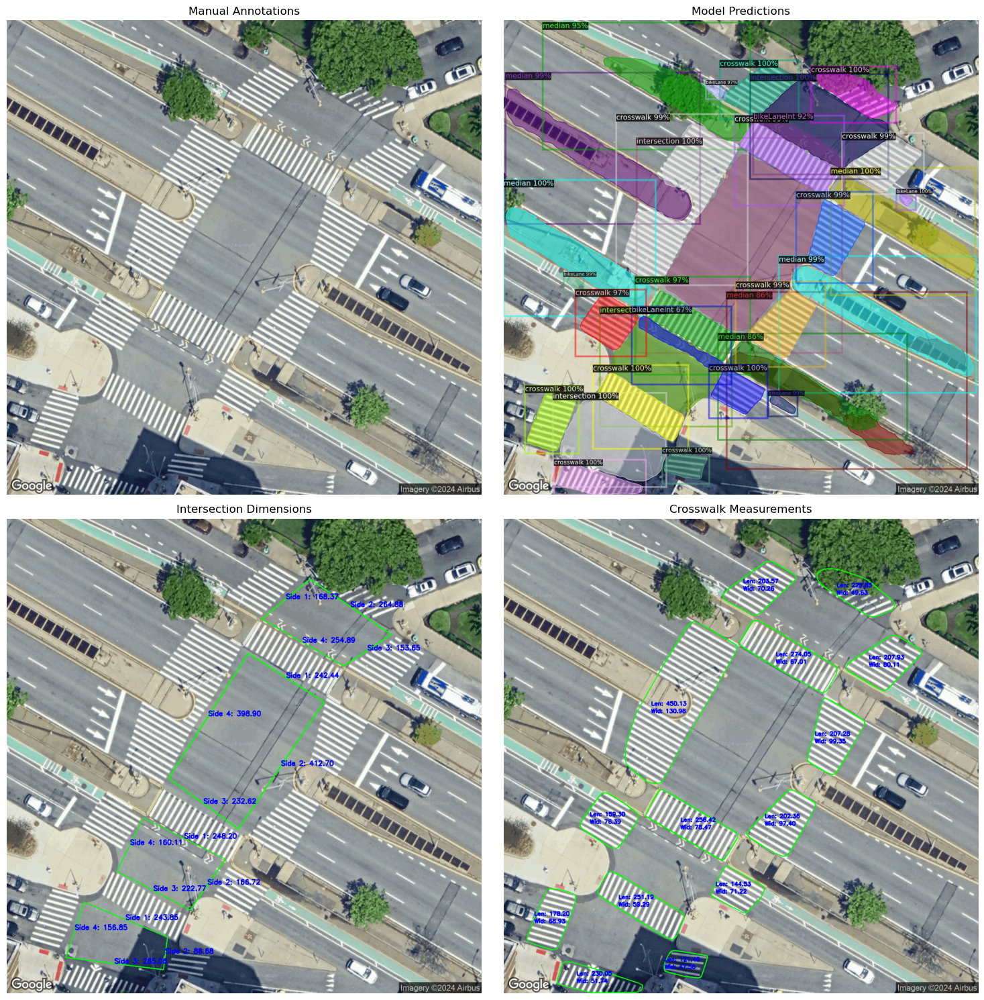

In [10]:
image_name = '40.721888_-73.845019.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)
image = cv2.imread(image_file_path)
predictions = predictor(image)
features = extract_features(image_file_path, predictions, class_names)

print(image_name)
display(features)
visualize_all_in_grid(image_file_path, predictor, metadata, None, class_names, fit_polygon_delaunay)
# visualize_annotations_predictions_grid(image_file_path, predictor, metadata, None, plot=True)

In [11]:
def visualize_model_predictions(
    predictor, img_file_path, metadata, 
    show_boxes=True, show_masks=True, classes_to_show=None
):
    img = cv2.imread(img_file_path)
    outputs = predictor(img)
    instances = outputs['instances'].to('cpu')
    
    if classes_to_show is not None:
        class_indices = torch.tensor([i for i, c in enumerate(instances.pred_classes) 
                                    if metadata.thing_classes[c] in classes_to_show])
        instances = instances[class_indices]
    
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    
    if show_boxes and show_masks:
        out = v.draw_instance_predictions(instances)
    elif show_boxes:
        out = v.overlay_instances(
            boxes=instances.pred_boxes,
            labels=[metadata.thing_classes[c] for c in instances.pred_classes]
        )
    elif show_masks:
        out = v.overlay_instances(
            masks=instances.pred_masks,
            labels=[metadata.thing_classes[c] for c in instances.pred_classes]
        )
        
    plt.figure(figsize=(15, 10))
    plt.imshow(out.get_image())
    plt.axis('off')
    plt.show()

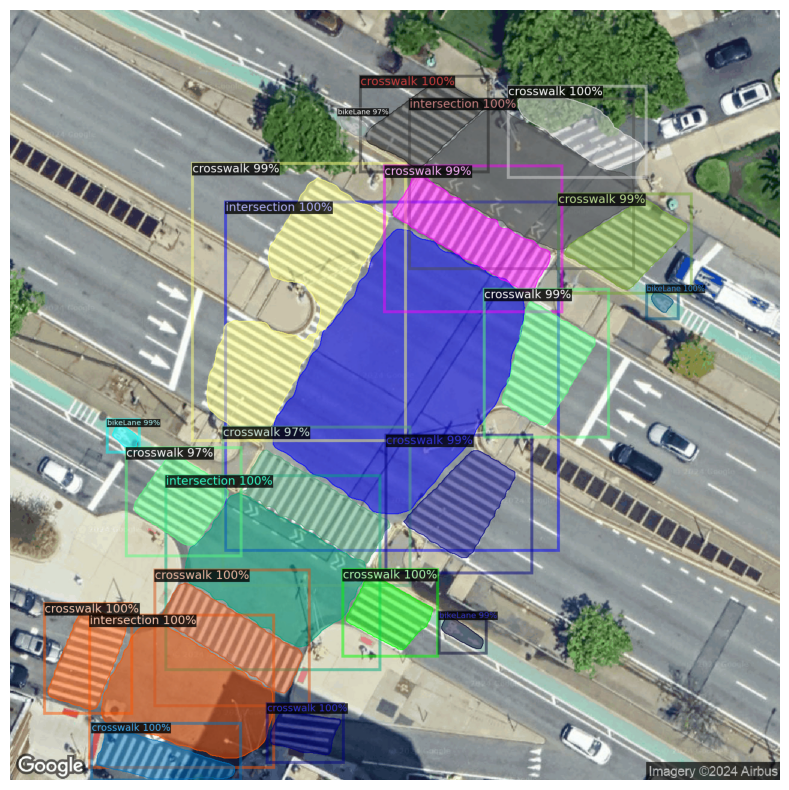

In [12]:
image_name = '40.721888_-73.845019.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['intersection', 'crosswalk', 'bikeLane']
)

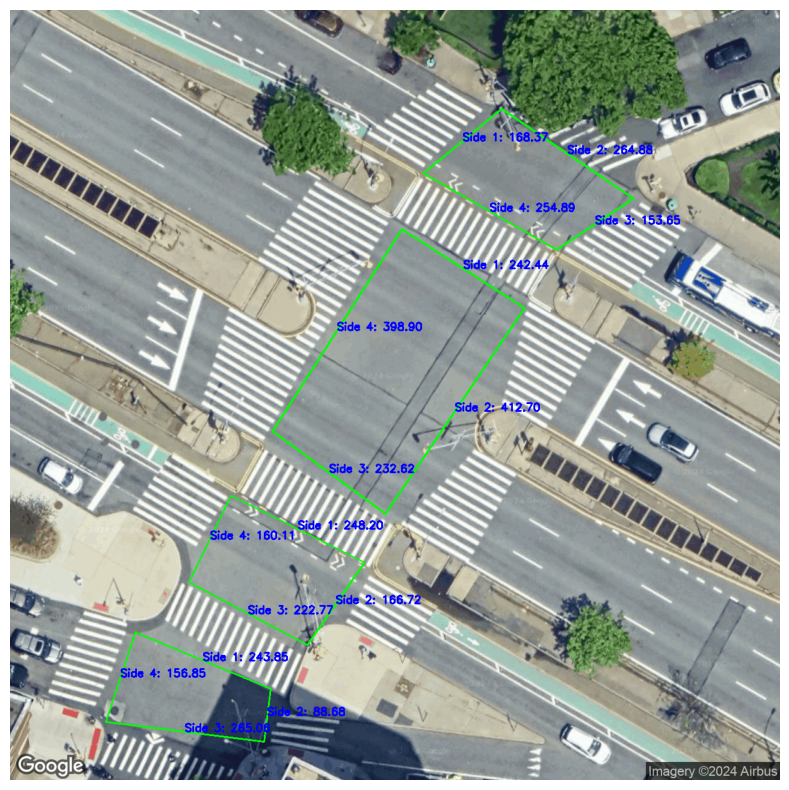

In [13]:
visualize_intersection_sides(predictor, image_file_path, metadata, class_names, fit_polygon_delaunay)

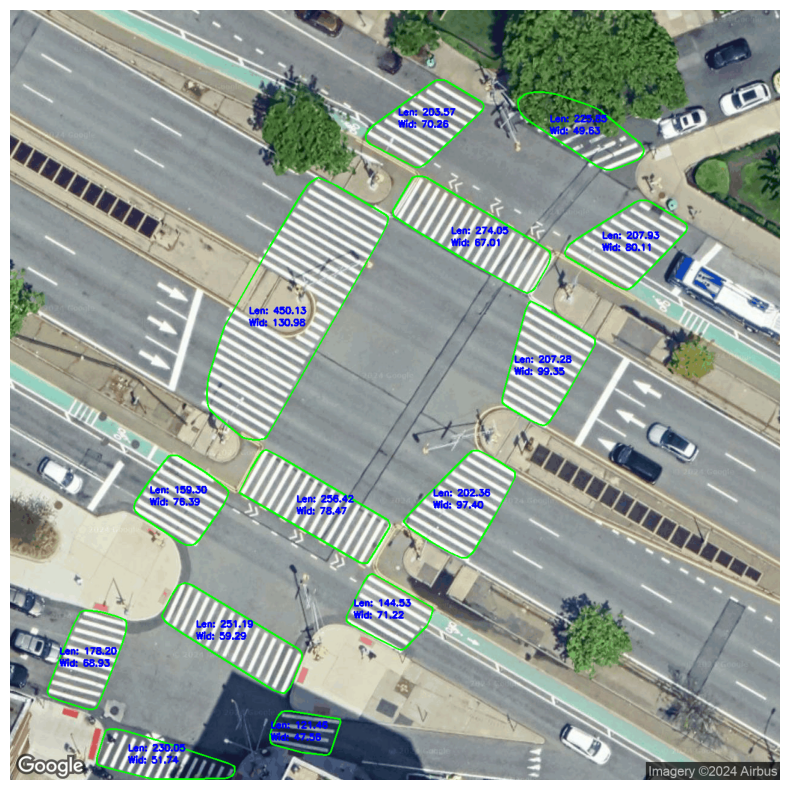

In [14]:
visualize_crosswalk_measurements(predictor, image_file_path, metadata, class_names, fit_polygon_delaunay)

### Large, Complex Intersection vs Simple

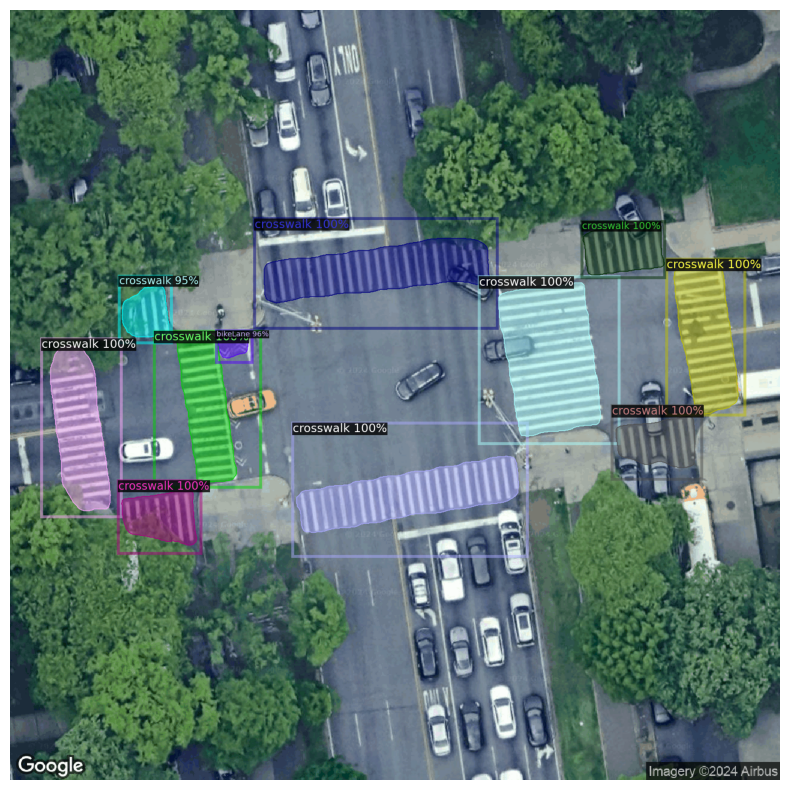

In [15]:
image_name = '40.636134_-73.972735.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['crosswalk', 'bikeLane']
)

# Distribution of Response

In [16]:
features_df = pd.read_csv('data/processed/image_features.csv')
intersections_df = pd.read_csv('data/processed/intersection_collision_frequency.csv')
df = pd.merge(intersections_df, features_df, how='left', left_on='dupe_key', right_on='image_name')
display(df.head(3).T)
print(f'Shape: {df.shape}')

,0,1,2
lat,40.744167,40.681686,40.811651
lng,-73.91248,-73.87157,-73.914474
intersection,True,True,True
lat_int,40.744167,40.681686,40.811651
lng_int,-73.91248,-73.87157,-73.914474
...,...,...,...
cw_side3_length,NaN,159.380049,NaN
cw_side3_width,NaN,56.067243,NaN
cw_side4_length,NaN,493.82183,NaN
cw_side4_width,NaN,45.38479,NaN


Shape: (39162, 66)


In [17]:
df = df[df.placename == 'New York']
df = df[df.total_collisions_sum > 0]
df = df[df.intersection_total_count > 0]
df = df[df.overpass_center != 1]
df = df[df.overpass_area <= 0.5]
df = df.set_index('dupe_key', drop=True)
df = df.fillna(0)
df.shape

(27121, 65)

In [18]:
# Aggregations
df['bike_lane_signage_index'] = (0.7 * df['bikeLane_total_count'] + 0.3 * df['bikeLaneInt_total_count'])
df['max_int_length'] = df[['int_side1_length', 'int_side2_length', 'int_side3_length', 'int_side4_length']].max(axis=1)
df['int_perimeter'] = df['int_side1_length'] + df['int_side2_length'] + df['int_side3_length'] + df['int_side4_length']
df['total_crosswalk_length'] = df['cw_side1_length'] + df['cw_side2_length'] + df['cw_side3_length'] + df['cw_side4_length']
df['crosswalk_gap'] = df['int_perimeter'] - df['total_crosswalk_length']
df['avg_crosswalk_width'] = df[['cw_side1_width', 'cw_side2_width', 'cw_side3_width', 'cw_side4_width']].mean(axis=1)
df['complexity_index'] = (
    df['intersection_total_count'] + df['crosswalk_total_count'] + df['median_total_count'] + 
    df['doubleYellow_total_count'] # + df['busLane_total_count']
) # * df['intersection_main_area']

# Interactions
df['complexity_x_signage'] = df['complexity_index'] * df['bike_lane_signage_index']
df['complexity_x_width'] = df['complexity_index'] * df['avg_crosswalk_width']
df['buslane_x_bikelane'] = df['busLane_total_count'] * df['bike_lane_signage_index']
df['area_x_complexity'] = df['intersection_main_area'] * df['complexity_index']

# Polynomials
# TBD

df.shape

(27121, 76)

In [19]:
df = df.drop([
    # Used for bike_lane_signage_index
    'bikeLane_total_count', 'bikeLaneInt_total_count', 'bikeLane_main_count', 'bikeLaneInt_main_count',
    # Used for int_perimeter
    'int_side1_length', 'int_side2_length', 'int_side3_length', 'int_side4_length',
    # Used for total_crosswalk_length and crosswalk_gap
    'cw_side1_length', 'cw_side2_length', 'cw_side3_length', 'cw_side4_length',
    # Used for avg_crosswalk_width
    'cw_side1_width', 'cw_side2_width', 'cw_side3_width', 'cw_side4_width',
    # Used for complexity_index
    'intersection_total_count', 'crosswalk_total_count', 'median_total_count', 'doubleYellow_total_count',
    # Not used
    'crosswalk_main_count', 'median_main_count', 'doubleYellow_main_count', 'busLane_main_count',
    'overpass_main_count', 'overpass_total_count', 
    # Found to be near-constant
    'overhead_area', 'overpass_center',
    # Multicolinearity
    'int_perimeter', 'total_crosswalk_length', # 'boro_name',
    # Leftover features from initial queries
    'image_name', 'lat', 'lng', 'intersection', 'lat_int', 'lng_int', 'mtfcc1', 'mtfcc2',
    'adminCode1', 'adminName1', 'distance_site_int', 'distance', 'bearing', 'placename', 
    'street1Bearing', 'street2Bearing', 'postalcode', 'countryCode', 'street1', 'street2',
    'adminName2'
], axis=1)

df.shape

(27121, 25)

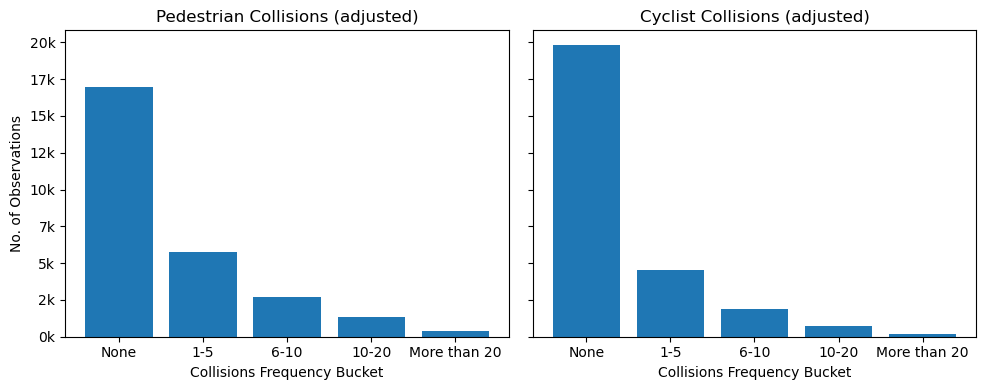

In [20]:
manual_cutoffs = {
    'ped': np.array([-1.,  1,  5,  10, 20, 100]),
    'cyc': np.array([-1.,  1,  5,  10, 20, 100]),
}
categories = ['None', '1-5', '6-10', '10-20', 'More than 20']

df['ped_collisions'] = df['ped_collisions_sum'] # / df['total_collisions_sum']
df['cyc_collisions'] = df['cyc_collisions_sum'] # / df['total_collisions_sum']

df['ped_collisions_buckets'] = pd.cut(df['ped_collisions'], bins=manual_cutoffs['ped'], labels=categories)
df['cyc_collisions_buckets'] = pd.cut(df['cyc_collisions'], bins=manual_cutoffs['cyc'], labels=categories)

cat_type = pd.api.types.CategoricalDtype(categories=categories, ordered=True)
df['ped_collisions_buckets'] = df['ped_collisions_buckets'].astype(cat_type)
df['cyc_collisions_buckets'] = df['cyc_collisions_buckets'].astype(cat_type)

# Create value counts with consistent ordering
ped_counts = df['ped_collisions_buckets'].value_counts().reindex(categories)
cyc_counts = df['cyc_collisions_buckets'].value_counts().reindex(categories)

fig, axes = plt.subplots(1, 2, figsize=(10, 4), sharey=True)
axes[0].bar(ped_counts.index, ped_counts.values)
axes[1].bar(cyc_counts.index, cyc_counts.values)

axes[0].set_title('Pedestrian Collisions (adjusted)')
axes[0].set_xlabel('Collisions Frequency Bucket')
axes[0].set_ylabel('No. of Observations')
axes[0].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x/1000)}k'))

axes[1].set_title('Cyclist Collisions (adjusted)')
axes[1].set_xlabel('Collisions Frequency Bucket')
axes[1].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x/1000)}k'))

plt.tight_layout()
plt.show()

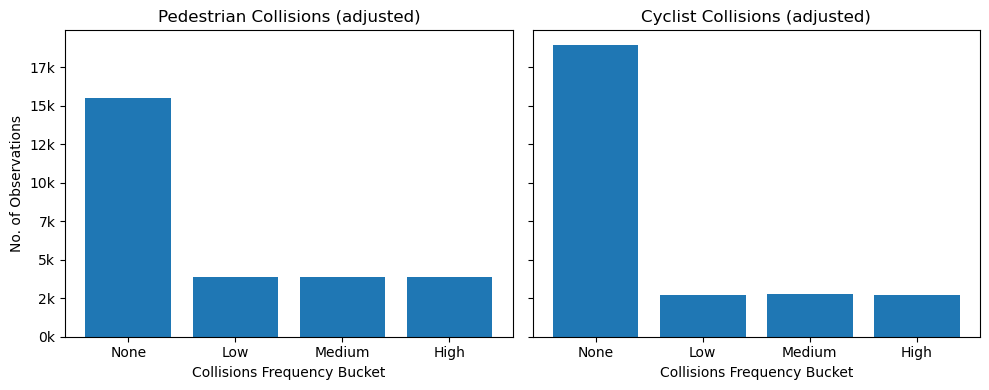

In [21]:
manual_cutoffs = {
    'ped': np.array([-1.,  0.0012987,  0.09302326,  0.19444444,  1.]),
    'cyc': np.array([-1.,  0.0012987,  0.07407407,  0.15873016,  1.]),
}
categories = ['None', 'Low', 'Medium', 'High']

df['ped_collisions'] = df['ped_collisions_sum'] / df['total_collisions_sum']
df['cyc_collisions'] = df['cyc_collisions_sum'] / df['total_collisions_sum']

df['ped_collisions_buckets'] = pd.cut(df['ped_collisions'], bins=manual_cutoffs['ped'], labels=categories)
df['cyc_collisions_buckets'] = pd.cut(df['cyc_collisions'], bins=manual_cutoffs['cyc'], labels=categories)

cat_type = pd.api.types.CategoricalDtype(categories=categories, ordered=True)
df['ped_collisions_buckets'] = df['ped_collisions_buckets'].astype(cat_type)
df['cyc_collisions_buckets'] = df['cyc_collisions_buckets'].astype(cat_type)

# Create value counts with consistent ordering
ped_counts = df['ped_collisions_buckets'].value_counts().reindex(categories)
cyc_counts = df['cyc_collisions_buckets'].value_counts().reindex(categories)

fig, axes = plt.subplots(1, 2, figsize=(10, 4), sharey=True)
axes[0].bar(ped_counts.index, ped_counts.values)
axes[1].bar(cyc_counts.index, cyc_counts.values)

axes[0].set_title('Pedestrian Collisions (adjusted)')
axes[0].set_xlabel('Collisions Frequency Bucket')
axes[0].set_ylabel('No. of Observations')
axes[0].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x/1000)}k'))

axes[1].set_title('Cyclist Collisions (adjusted)')
axes[1].set_xlabel('Collisions Frequency Bucket')
axes[1].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x/1000)}k'))

plt.tight_layout()
plt.show()

# Visualize Results

In [22]:
annotated_images = [f.replace('.json', '') for f in os.listdir(ANNOTATIONS_DIR) if '_' in f]
df.loc[[x for x in df.index if x in annotated_images]].sort_values(by='bike_lane_signage_index', ascending=False).head(10)

,ped_collisions_sum,cyc_collisions_sum,pedcyc_collisions_sum,total_collisions_sum,ped_injuries_sum,cyc_injuries_sum,pedcyc_injuries_sum,total_injuries_sum,ped_killed_sum,cyc_killed_sum,...,avg_crosswalk_width,complexity_index,complexity_x_signage,complexity_x_width,buslane_x_bikelane,area_x_complexity,ped_collisions,cyc_collisions,ped_collisions_buckets,cyc_collisions_buckets
dupe_key,,,,,,,,,,,,,,,,,,,,,
40.722933_-73.988643,32.0,41.0,73.0,261.0,23.0,41.0,64.0,153.0,9.0,0.0,...,73.854594,18,158.4,1329.382687,26.4,4627692.0,0.122605,0.157088,Medium,Medium
40.767914_-73.925417,2.0,3.0,5.0,22.0,2.0,3.0,5.0,5.0,0.0,0.0,...,39.455085,6,49.8,236.730508,0.0,350730.0,0.090909,0.136364,Low,Medium
40.760599_-73.964314,11.0,38.0,49.0,342.0,11.0,38.0,49.0,142.0,0.0,0.0,...,35.189434,9,68.4,316.704905,30.4,907587.0,0.032164,0.111111,Low,Medium
40.718145_-73.993828,33.0,53.0,86.0,183.0,30.0,53.0,83.0,106.0,3.0,0.0,...,50.322533,10,75.0,503.225332,0.0,820670.0,0.180328,0.289617,Medium,High
40.821856_-73.84869,0.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,...,28.753362,7,52.5,201.273536,0.0,590163.0,0.000000,0.000000,None,None
40.69622_-73.9871,22.0,42.0,64.0,327.0,22.0,42.0,64.0,141.0,0.0,0.0,...,77.005660,15,112.5,1155.084894,7.5,2668710.0,0.067278,0.128440,Low,Medium
40.594527_-73.934006,4.0,0.0,4.0,36.0,4.0,0.0,4.0,26.0,0.0,0.0,...,27.275009,7,47.6,190.925065,0.0,369712.0,0.111111,0.000000,Medium,None
40.663517_-73.95721,6.0,50.0,56.0,178.0,6.0,50.0,56.0,111.0,0.0,0.0,...,64.833027,12,81.6,777.996330,0.0,1126320.0,0.033708,0.280899,Low,High
40.652633_-74.006174,24.0,42.0,66.0,169.0,24.0,42.0,66.0,99.0,0.0,0.0,...,65.698738,11,68.2,722.686118,0.0,930501.0,0.142012,0.248521,Medium,High


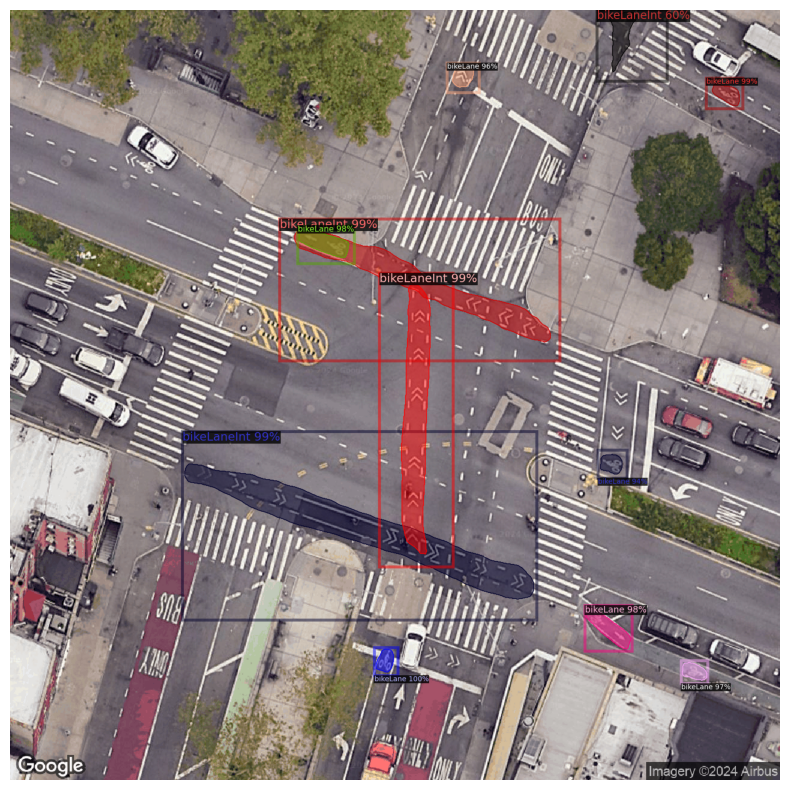

In [23]:
image_name = '40.722933_-73.988643.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['bikeLane', 'bikeLaneInt']
)

In [24]:
df.loc[[x for x in df.index if x in annotated_images]].sort_values(by='avg_crosswalk_width', ascending=False).head(10)

,ped_collisions_sum,cyc_collisions_sum,pedcyc_collisions_sum,total_collisions_sum,ped_injuries_sum,cyc_injuries_sum,pedcyc_injuries_sum,total_injuries_sum,ped_killed_sum,cyc_killed_sum,...,avg_crosswalk_width,complexity_index,complexity_x_signage,complexity_x_width,buslane_x_bikelane,area_x_complexity,ped_collisions,cyc_collisions,ped_collisions_buckets,cyc_collisions_buckets
dupe_key,,,,,,,,,,,,,,,,,,,,,
40.821637_-73.939077,55.0,25.0,78.0,295.0,53.0,25.0,76.0,177.0,0.0,0.0,...,96.865518,14,0.0,1356.117257,0.0,2560782.0,0.186441,0.084746,Medium,Medium
40.807773_-73.945482,88.0,43.0,131.0,361.0,80.0,43.0,123.0,234.0,6.0,0.0,...,92.773036,13,0.0,1206.049463,0.0,1846195.0,0.243767,0.119114,High,Medium
40.820438_-73.936227,24.0,43.0,67.0,369.0,22.0,43.0,65.0,191.0,9.0,0.0,...,92.597474,10,0.0,925.974740,0.0,1390840.0,0.065041,0.116531,Low,Medium
40.813375_-73.956269,36.0,44.0,80.0,381.0,34.0,44.0,78.0,168.0,0.0,0.0,...,91.844579,10,21.0,918.445793,0.0,1407330.0,0.094488,0.115486,Medium,Medium
40.862749_-73.904934,56.0,6.0,62.0,381.0,56.0,6.0,62.0,192.0,0.0,0.0,...,88.636527,12,0.0,1063.638327,0.0,2143488.0,0.146982,0.015748,Medium,Low
40.822837_-73.941917,63.0,37.0,100.0,358.0,58.0,37.0,95.0,202.0,5.0,0.0,...,86.577623,9,0.0,779.198605,0.0,956115.0,0.175978,0.103352,Medium,Medium
40.609809_-73.922498,51.0,7.0,58.0,543.0,51.0,7.0,58.0,256.0,0.0,0.0,...,83.200713,23,0.0,1913.616410,0.0,8587740.0,0.093923,0.012891,Medium,Low
40.718612_-73.988173,52.0,19.0,71.0,330.0,51.0,19.0,70.0,141.0,0.0,0.0,...,81.865305,13,53.3,1064.248965,20.5,2063412.0,0.157576,0.057576,Medium,Low
40.826202_-73.821676,48.0,0.0,48.0,159.0,47.0,0.0,47.0,83.0,0.0,0.0,...,80.132530,9,0.0,721.192772,0.0,867204.0,0.301887,0.000000,High,None


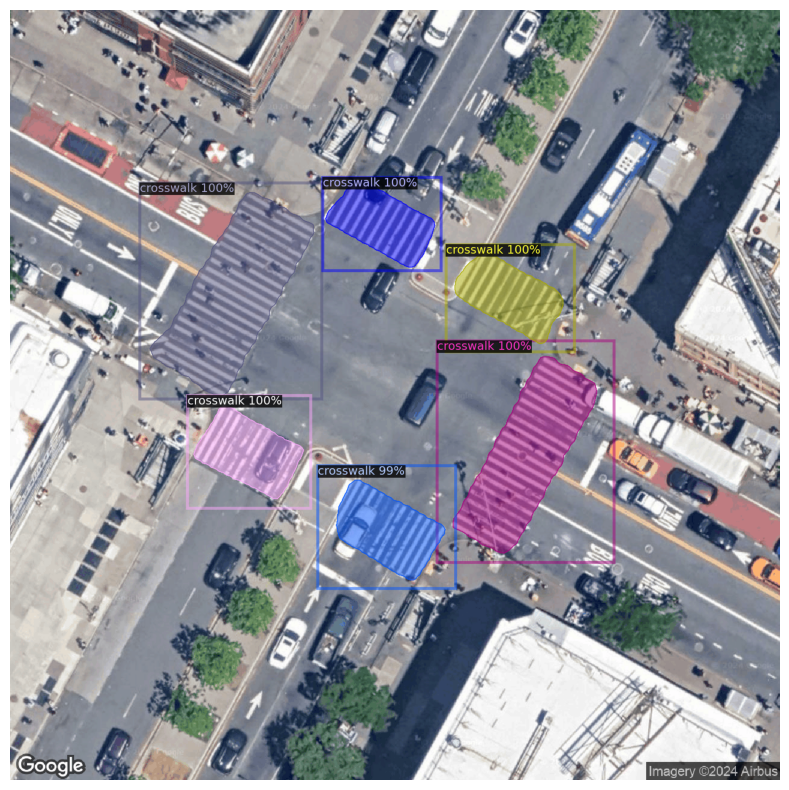

In [25]:
image_name = '40.807773_-73.945482.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['crosswalk']
)

In [26]:
df.loc[[x for x in df.index if x in annotated_images]].sort_values(by='max_int_length', ascending=False).head(10)

,ped_collisions_sum,cyc_collisions_sum,pedcyc_collisions_sum,total_collisions_sum,ped_injuries_sum,cyc_injuries_sum,pedcyc_injuries_sum,total_injuries_sum,ped_killed_sum,cyc_killed_sum,...,avg_crosswalk_width,complexity_index,complexity_x_signage,complexity_x_width,buslane_x_bikelane,area_x_complexity,ped_collisions,cyc_collisions,ped_collisions_buckets,cyc_collisions_buckets
dupe_key,,,,,,,,,,,,,,,,,,,,,
40.658576_-73.890621,34.0,18.0,52.0,702.0,29.0,14.0,43.0,321.0,4.0,4.0,...,28.228975,20,0.0,564.579495,0.0,6181680.0,0.048433,0.025641,Low,Low
40.609809_-73.922498,51.0,7.0,58.0,543.0,51.0,7.0,58.0,256.0,0.0,0.0,...,83.200713,23,0.0,1913.616410,0.0,8587740.0,0.093923,0.012891,Medium,Low
40.659651_-73.77383,11.0,0.0,11.0,604.0,10.0,0.0,10.0,273.0,0.0,0.0,...,33.502077,11,0.0,368.522849,0.0,3396206.0,0.018212,0.000000,Low,None
40.719895_-73.992936,30.0,50.0,76.0,284.0,27.0,50.0,73.0,144.0,3.0,0.0,...,75.814187,16,41.6,1213.026992,7.8,3775040.0,0.105634,0.176056,Medium,High
40.696127_-73.984514,15.0,14.0,29.0,894.0,15.0,14.0,29.0,286.0,0.0,0.0,...,70.200312,19,0.0,1333.805924,0.0,6529882.0,0.016779,0.015660,Low,Low
40.719039_-74.012292,4.0,0.0,4.0,70.0,4.0,0.0,4.0,44.0,0.0,0.0,...,65.491482,16,56.0,1047.863714,0.0,3721104.0,0.057143,0.000000,Low,None
40.678163_-73.897475,1.0,1.0,2.0,770.0,1.0,1.0,2.0,366.0,0.0,0.0,...,63.300649,21,0.0,1329.313635,0.0,4332741.0,0.001299,0.001299,Low,Low
40.722933_-73.988643,32.0,41.0,73.0,261.0,23.0,41.0,64.0,153.0,9.0,0.0,...,73.854594,18,158.4,1329.382687,26.4,4627692.0,0.122605,0.157088,Medium,Medium
40.69622_-73.9871,22.0,42.0,64.0,327.0,22.0,42.0,64.0,141.0,0.0,0.0,...,77.005660,15,112.5,1155.084894,7.5,2668710.0,0.067278,0.128440,Low,Medium


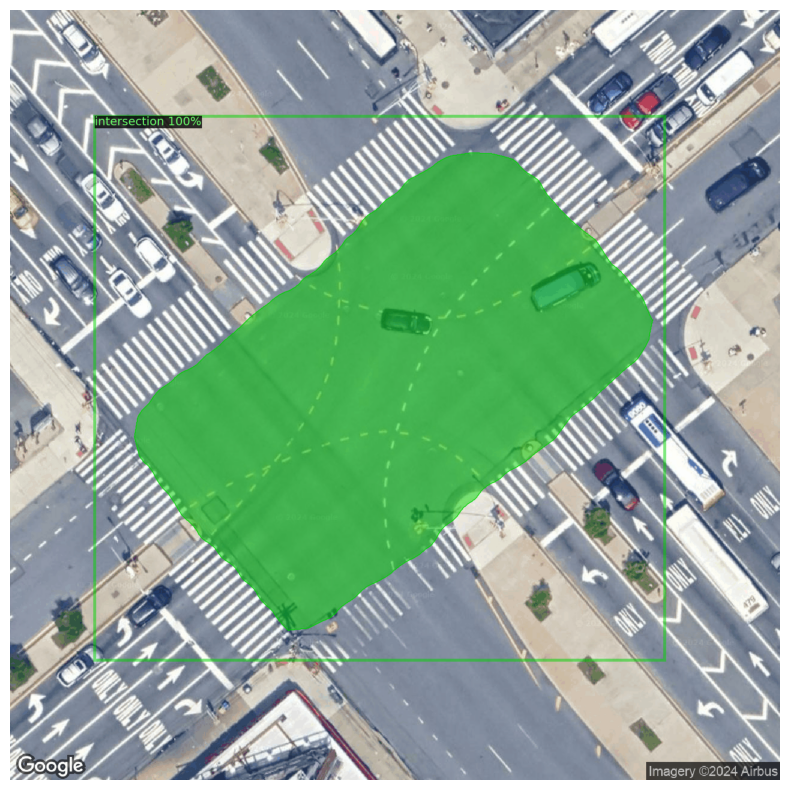

In [27]:
image_name = '40.609809_-73.922498.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['intersection']
)

In [28]:
df.loc[[x for x in df.index if x in annotated_images]].sort_values(by='complexity_index', ascending=False).head(10)

,ped_collisions_sum,cyc_collisions_sum,pedcyc_collisions_sum,total_collisions_sum,ped_injuries_sum,cyc_injuries_sum,pedcyc_injuries_sum,total_injuries_sum,ped_killed_sum,cyc_killed_sum,...,avg_crosswalk_width,complexity_index,complexity_x_signage,complexity_x_width,buslane_x_bikelane,area_x_complexity,ped_collisions,cyc_collisions,ped_collisions_buckets,cyc_collisions_buckets
dupe_key,,,,,,,,,,,,,,,,,,,,,
40.609809_-73.922498,51.0,7.0,58.0,543.0,51.0,7.0,58.0,256.0,0.0,0.0,...,83.200713,23,0.0,1913.616410,0.0,8587740.0,0.093923,0.012891,Medium,Low
40.636134_-73.972735,16.0,10.0,26.0,150.0,15.0,10.0,25.0,90.0,0.0,0.0,...,72.980285,21,29.4,1532.585976,0.0,2819922.0,0.106667,0.066667,Medium,Low
40.678163_-73.897475,1.0,1.0,2.0,770.0,1.0,1.0,2.0,366.0,0.0,0.0,...,63.300649,21,0.0,1329.313635,0.0,4332741.0,0.001299,0.001299,Low,Low
40.668496_-73.925598,26.0,28.0,54.0,1002.0,24.0,28.0,52.0,460.0,0.0,0.0,...,54.472846,21,58.8,1143.929764,0.0,2026542.0,0.025948,0.027944,Low,Low
40.658576_-73.890621,34.0,18.0,52.0,702.0,29.0,14.0,43.0,321.0,4.0,4.0,...,28.228975,20,0.0,564.579495,0.0,6181680.0,0.048433,0.025641,Low,Low
40.696127_-73.984514,15.0,14.0,29.0,894.0,15.0,14.0,29.0,286.0,0.0,0.0,...,70.200312,19,0.0,1333.805924,0.0,6529882.0,0.016779,0.015660,Low,Low
40.722933_-73.988643,32.0,41.0,73.0,261.0,23.0,41.0,64.0,153.0,9.0,0.0,...,73.854594,18,158.4,1329.382687,26.4,4627692.0,0.122605,0.157088,Medium,Medium
40.668647_-73.92835,19.0,17.0,36.0,552.0,19.0,17.0,36.0,374.0,0.0,0.0,...,74.020163,17,0.0,1258.342772,0.0,1442773.0,0.034420,0.030797,Low,Low
40.877513_-73.866874,0.0,0.0,0.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,...,53.611561,17,34.0,911.396538,2.0,1059304.0,0.000000,0.000000,None,None


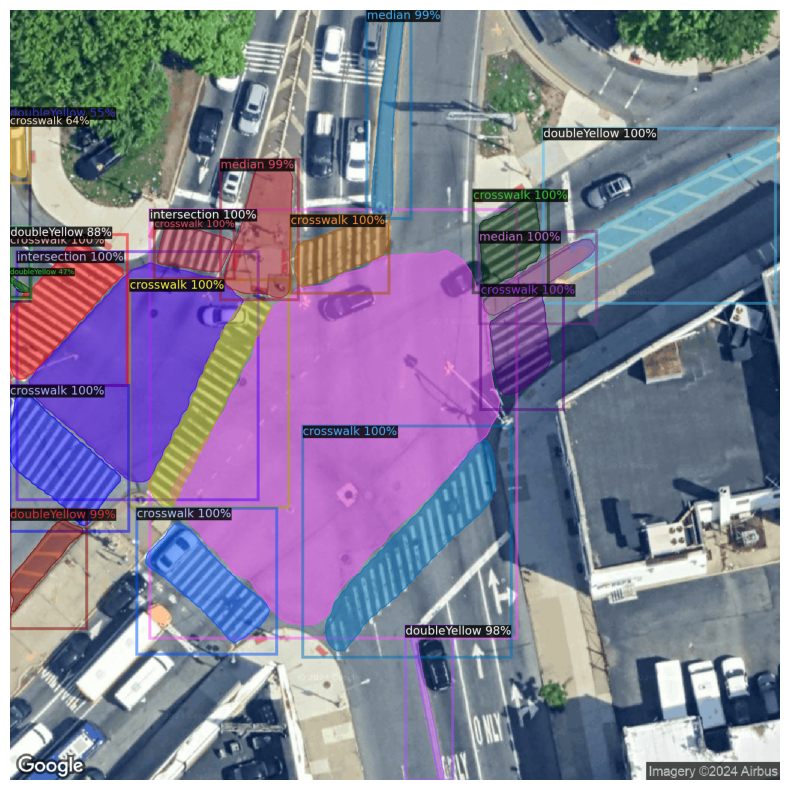

In [29]:
image_name = '40.678163_-73.897475.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['intersection', 'crosswalk', 'doubleYellow', 'median']
)

In [45]:
df.loc[[x for x in df.index if x in annotated_images], [x for x in df.columns if '_sum' not in x]].sort_values(by=['complexity_index', 'bike_lane_signage_index'], ascending=False).head(10)

,boro_name,busLane_total_count,overpass_area,intersection_main_area,bike_lane_signage_index,max_int_length,crosswalk_gap,avg_crosswalk_width,complexity_index,complexity_x_signage,complexity_x_width,buslane_x_bikelane,area_x_complexity,ped_collisions,cyc_collisions,ped_collisions_buckets,cyc_collisions_buckets
dupe_key,,,,,,,,,,,,,,,,,
40.609809_-73.922498,Brooklyn,0,0.000000,373380.0,0.0,770.880017,124.091434,83.200713,23,0.0,1913.616410,0.0,8587740.0,0.093923,0.012891,Medium,Low
40.668496_-73.925598,Brooklyn,0,0.000000,96502.0,2.8,356.275175,319.702116,54.472846,21,58.8,1143.929764,0.0,2026542.0,0.025948,0.027944,Low,Low
40.636134_-73.972735,Brooklyn,0,0.000000,134282.0,1.4,439.829512,74.956983,72.980285,21,29.4,1532.585976,0.0,2819922.0,0.106667,0.066667,Medium,Low
40.678163_-73.897475,Brooklyn,0,0.000000,206321.0,0.0,613.267478,115.872890,63.300649,21,0.0,1329.313635,0.0,4332741.0,0.001299,0.001299,Low,Low
40.658576_-73.890621,Brooklyn,0,0.000000,309084.0,0.0,818.873617,645.891309,28.228975,20,0.0,564.579495,0.0,6181680.0,0.048433,0.025641,Low,Low
40.696127_-73.984514,Brooklyn,0,0.000000,343678.0,0.0,648.361782,417.368642,70.200312,19,0.0,1333.805924,0.0,6529882.0,0.016779,0.015660,Low,Low
40.722933_-73.988643,Manhattan,3,0.000000,257094.0,8.8,598.689402,332.619662,73.854594,18,158.4,1329.382687,26.4,4627692.0,0.122605,0.157088,Medium,Medium
40.877513_-73.866874,Bronx,1,0.177453,62312.0,2.0,379.353397,117.134851,53.611561,17,34.0,911.396538,2.0,1059304.0,0.000000,0.000000,None,None
40.668798_-73.931119,Brooklyn,0,0.000000,97353.0,1.4,410.410770,296.314607,55.681231,17,23.8,946.580933,0.0,1655001.0,0.142857,0.010989,Medium,Low


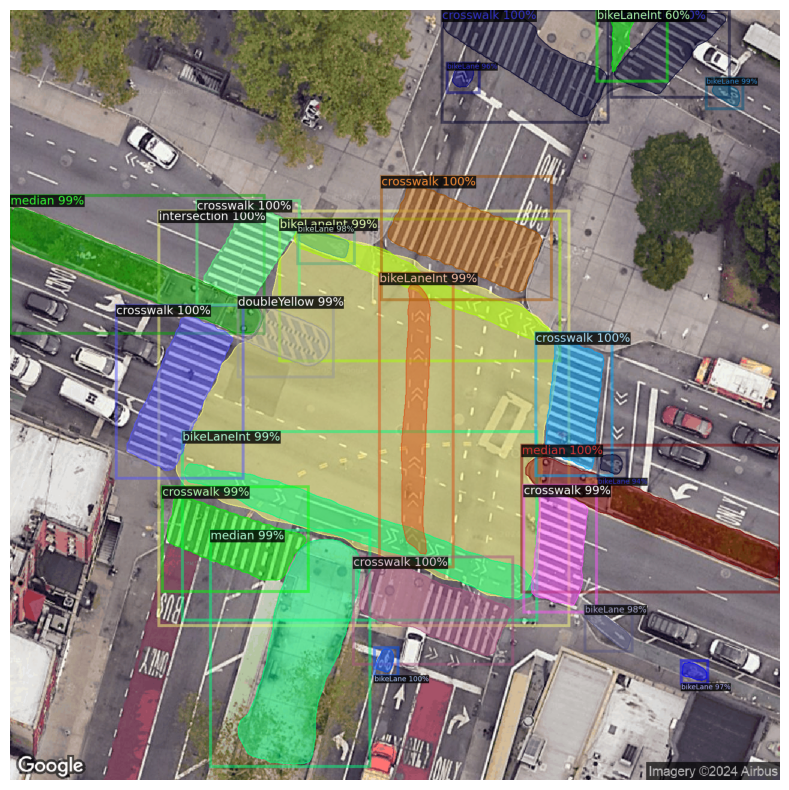

In [44]:
image_name = '40.722933_-73.988643.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['intersection', 'crosswalk', 'doubleYellow', 'median', 'bikeLane', 'bikeLaneInt']
)

In [46]:
df.loc[[x for x in df.index if x in annotated_images], [x for x in df.columns if '_sum' not in x]].sort_values(by=['avg_crosswalk_width', 'bike_lane_signage_index'], ascending=False).head(10)

,boro_name,busLane_total_count,overpass_area,intersection_main_area,bike_lane_signage_index,max_int_length,crosswalk_gap,avg_crosswalk_width,complexity_index,complexity_x_signage,complexity_x_width,buslane_x_bikelane,area_x_complexity,ped_collisions,cyc_collisions,ped_collisions_buckets,cyc_collisions_buckets
dupe_key,,,,,,,,,,,,,,,,,
40.821637_-73.939077,Manhattan,0,0.0,182913.0,0.0,537.573251,78.325633,96.865518,14,0.0,1356.117257,0.0,2560782.0,0.186441,0.084746,Medium,Medium
40.807773_-73.945482,Manhattan,2,0.0,142015.0,0.0,415.269792,36.722999,92.773036,13,0.0,1206.049463,0.0,1846195.0,0.243767,0.119114,High,Medium
40.820438_-73.936227,Manhattan,0,0.0,139084.0,0.0,410.991484,-98.662675,92.597474,10,0.0,925.974740,0.0,1390840.0,0.065041,0.116531,Low,Medium
40.813375_-73.956269,Manhattan,0,0.0,140733.0,2.1,422.246374,-195.327989,91.844579,10,21.0,918.445793,0.0,1407330.0,0.094488,0.115486,Medium,Medium
40.862749_-73.904934,Bronx,9,0.0,178624.0,0.0,484.580231,-251.044510,88.636527,12,0.0,1063.638327,0.0,2143488.0,0.146982,0.015748,Medium,Low
40.822837_-73.941917,Manhattan,0,0.0,106235.0,0.0,314.696679,-85.861663,86.577623,9,0.0,779.198605,0.0,956115.0,0.175978,0.103352,Medium,Medium
40.609809_-73.922498,Brooklyn,0,0.0,373380.0,0.0,770.880017,124.091434,83.200713,23,0.0,1913.616410,0.0,8587740.0,0.093923,0.012891,Medium,Low
40.718612_-73.988173,Manhattan,5,0.0,158724.0,4.1,543.478610,-33.752766,81.865305,13,53.3,1064.248965,20.5,2063412.0,0.157576,0.057576,Medium,Low
40.826202_-73.821676,Bronx,0,0.0,96356.0,0.0,345.973987,-112.804548,80.132530,9,0.0,721.192772,0.0,867204.0,0.301887,0.000000,High,None


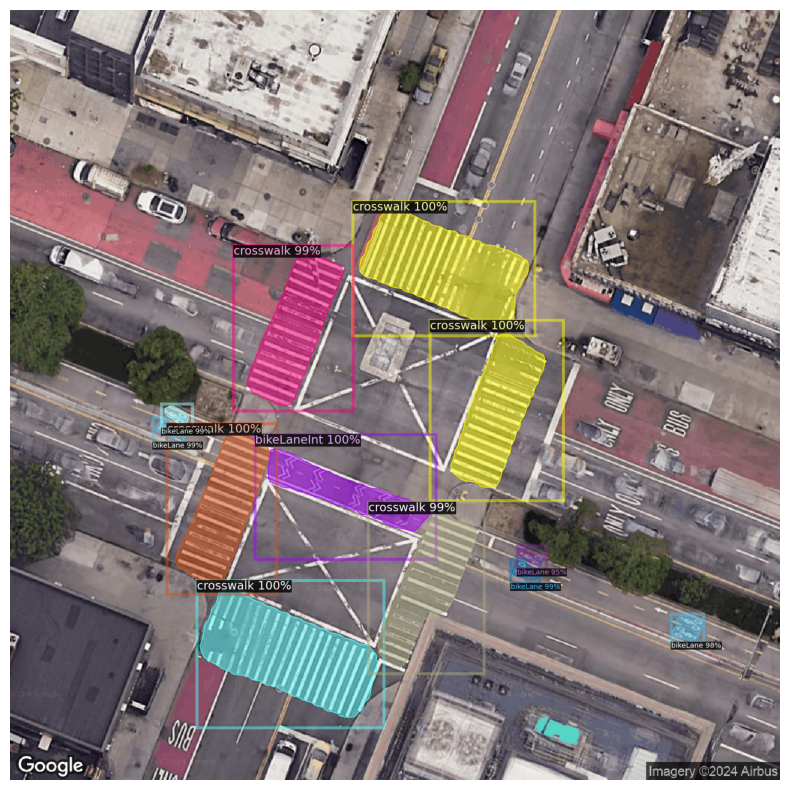

In [47]:
image_name = '40.718612_-73.988173.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['crosswalk', 'bikeLane', 'bikeLaneInt']
)

In [48]:
df.loc[[x for x in df.index if x in annotated_images], [x for x in df.columns if '_sum' not in x]].sort_values(by='crosswalk_gap', ascending=False).head(10)

,boro_name,busLane_total_count,overpass_area,intersection_main_area,bike_lane_signage_index,max_int_length,crosswalk_gap,avg_crosswalk_width,complexity_index,complexity_x_signage,complexity_x_width,buslane_x_bikelane,area_x_complexity,ped_collisions,cyc_collisions,ped_collisions_buckets,cyc_collisions_buckets
dupe_key,,,,,,,,,,,,,,,,,
40.720263_-73.911889,Queens,0,0.065966,128125.0,0.0,532.304424,1458.590545,0.000000,3,0.0,0.000000,0.0,384375.0,0.000000,0.00,None,None
40.717931_-73.736958,Queens,0,0.000000,87553.0,0.0,387.722839,950.298605,16.943018,5,0.0,84.715088,0.0,437765.0,0.070423,0.00,Low,None
40.659651_-73.77383,Queens,0,0.000000,308746.0,0.0,724.347983,935.184797,33.502077,11,0.0,368.522849,0.0,3396206.0,0.018212,0.00,Low,None
40.884969_-73.830337,Bronx,0,0.000000,120707.0,0.0,392.229525,900.407861,29.297313,6,0.0,175.783879,0.0,724242.0,0.000000,0.00,None,None
40.74_-73.947601,Queens,0,0.000000,56099.0,0.0,229.732453,879.412885,0.000000,5,0.0,0.000000,0.0,280495.0,0.000000,0.00,None,None
40.675631_-74.003503,Brooklyn,0,0.000000,49709.0,0.7,246.142235,813.863252,0.000000,3,2.1,0.000000,0.0,149127.0,0.000000,0.00,None,None
40.811369_-73.89148,Bronx,0,0.000000,115675.0,4.8,434.626276,778.972035,36.769340,11,52.8,404.462742,0.0,1272425.0,0.000000,0.00,None,None
40.731893_-74.003791,Manhattan,0,0.000000,55071.0,2.4,299.125392,771.676711,16.258461,6,14.4,97.550768,0.0,330426.0,0.333333,0.00,High,None
40.61622_-74.083234,Staten Island,0,0.000000,85685.0,0.0,387.200207,770.944527,27.790150,3,0.0,83.370451,0.0,257055.0,0.000000,0.00,None,None


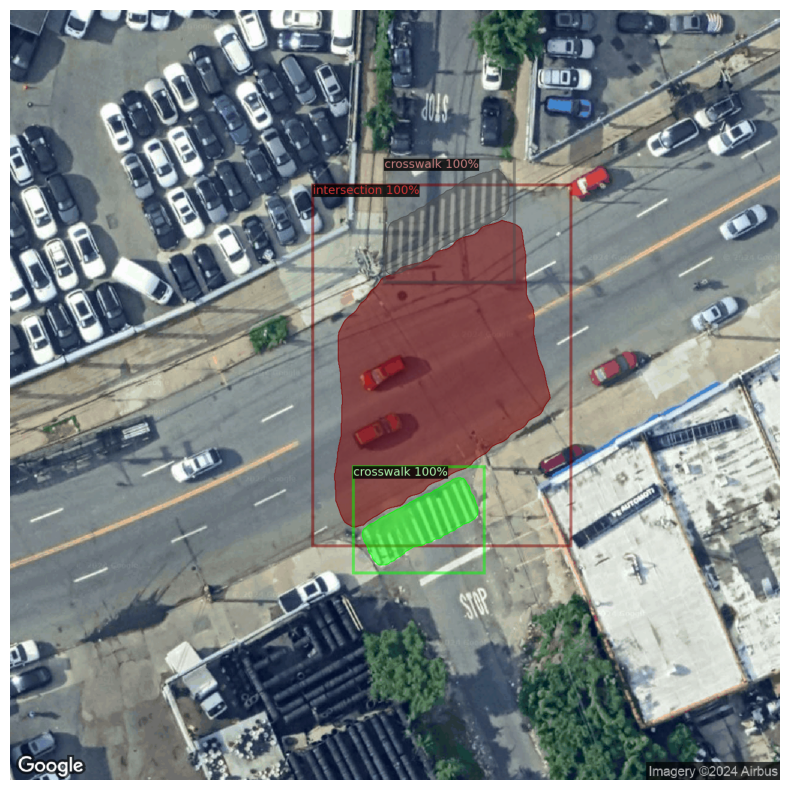

In [56]:
image_name = '40.884969_-73.830337.png'
image_file_path = os.path.join(IMAGES_DIR, image_name)

visualize_model_predictions(
    predictor, image_file_path, metadata,
    show_boxes=True, show_masks=True,
    classes_to_show=['crosswalk', 'intersection']
)